If I was a betting man (I'm not!) I would say we're moving on to Monte Carlo methods and random numbers! 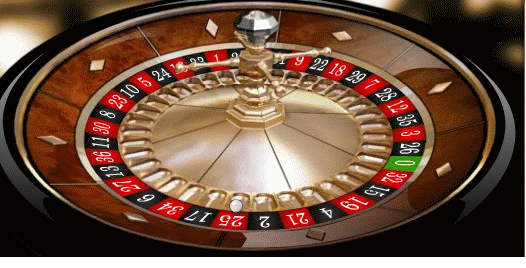

In [ ]:
# Code to estimate pi
from numpy import random,sqrt,pi
import time

tstart = time.perf_counter()

N = 5000000
nin = 0
for i in range(N):
  x = random.uniform(-1,1,1)
  y = random.uniform(-1,1,1)
  r = sqrt(x*x+y*y)  
  if (r < 1):
    nin = nin+1
tend = time.perf_counter()

print("Estimate for pi with N = ",N," is ",4*nin/N)
print("The estimate took ",(tend - tstart),"seconds")

Estimate for pi with N =  5000000  is  3.1415888
The estimate took  55.02203737100001 seconds


In [ ]:
# Faster way to check if the points are inside the circle
# General rule is to avoid "for" loops if a simple numpy expression can be written

from numpy import zeros,random,pi
import time

tstart = time.perf_counter()

N = 5000000

results = zeros(N)
x_values = random.uniform(-1, 1, N)
y_values = random.uniform(-1, 1, N)
# the following means: "for the indices where the point satisifies x**2 + y**2 <= 1, set results to 1"
# note that we don't actually need the square root, either! And the mean is perfect to use since for zeros or ones it is just the fraction passing, which is what we want
results[x_values**2 + y_values**2 <= 1] = 1

tend = time.perf_counter()

print("Estimate for pi with N = ",N," is ",4*results.mean())
print("The estimate took ",(tend - tstart),"seconds")

Estimate for pi with N =  5000000  is  3.1418008
The estimate took  0.1766990120000287 seconds


In [ ]:
# Even faster - skip filling the results array, since we don't actually care *which* points are inside the
# circle, just how many there are
# when the expression is True, sum counts it as 1, and when the expression is False, sum counts it as zero

from numpy import zeros,random,pi,sum
import time

tstart = time.perf_counter()

N = 5000000

results = zeros(N)
x_values = random.uniform(-1, 1, N)
y_values = random.uniform(-1, 1, N)
count = sum(x_values**2 + y_values**2 <= 1)

tend = time.perf_counter()
print("Estimate for pi with N = ",N," is ",4*count/N)
print("The estimate took ",(tend - tstart),"seconds")

Estimate for pi with N =  5000000  is  3.1427208
The estimate took  0.15959697000005235 seconds


In [ ]:
# Even faster - skip filling the results array, since we don't actually care *which* points are inside the
# circle, just how many there are
# when the expression is True, sum counts it as 1, and when the expression is False, sum counts it as zero
### now do a large scale check
from numpy import zeros,random,pi,sum
import time

tstart = time.perf_counter()

N = 50000000

results = zeros(N)
x_values = random.uniform(-1, 1, N)
y_values = random.uniform(-1, 1, N)
count = sum(x_values**2 + y_values**2 <= 1)

tend = time.perf_counter()
print("Estimate for pi with N = ",N," is ",4*count/N)
print("The estimate took ",(tend - tstart),"seconds")

Estimate for pi with N =  50000000  is  3.14116336
The estimate took  1.9479021709999955 seconds


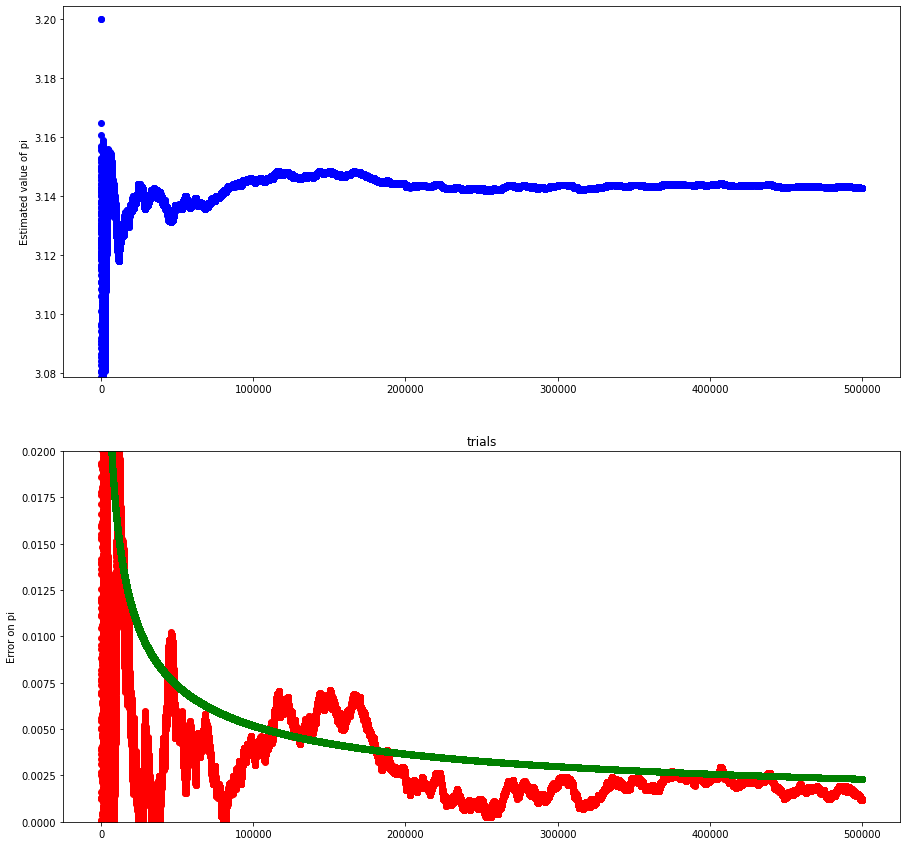

In [ ]:
from matplotlib import pyplot as plot
from numpy import random,sqrt,pi

### probability of being inside = pi/4 = p for a binomial
### variance of a binomial = n*p*(1-p), sigma is sqrt(n*p*(1-p)). 
### But that sigma is on the total number, the sigma on the fraction is that
### number divided by n = sqrt(p*(1-p)/n)
### Value of pi = 4p, uncertainty on it is 4*sqrt(p*(1-p)/n)

N = 500000
xs = []
ys = []
ydiffs = []
binomialdiffs = []
nin = 0
p = pi/4
for i in range(N):
  x = random.uniform(-1,1,1)
  y = random.uniform(-1,1,1)
  r = sqrt(x*x+y*y)  
  if (r < 1):
    nin = nin+1
  thispi = 4.*nin/(i+1) ### divide by i+1 because we finished ith entry already
  xs.append(i)
  ys.append(thispi)
  ydiffs.append(abs(pi-thispi))
  binomialdiffs.append(4*sqrt(p*(1-p)/(i+1)))

figs,axes = plot.subplots(2,figsize=(15,15))
axes[0].scatter(xs,ys,color='b')
axes[0].set(ylabel="Estimated value of pi")
axes[0].set(ylim=[0.98*pi,1.02*pi])
axes[1].scatter(xs,ydiffs,color='r')
axes[1].scatter(xs,binomialdiffs,color='g')
axes[1].set_title("trials")
axes[1].set(ylabel="Error on pi")
axes[1].set(ylim=[0,0.02])
plot.show()

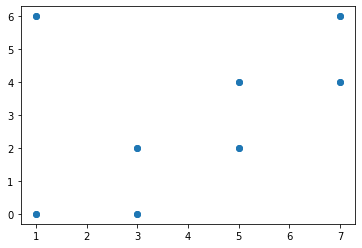

In [ ]:
# Checking pseudo-random numbers - ewww
import matplotlib.pyplot as plt

N = 8
a = 5
c = 3
m = 8
x = 1
y = 0
xvalues = []
yvalues = []

for i in range(N):
  y = (a*x+c)%m
  xvalues.append(x)
  yvalues.append(y)
  x = (a*y+c)%m
  xvalues.append(x)
  yvalues.append(y)

plt.scatter(xvalues,yvalues)
plt.show()

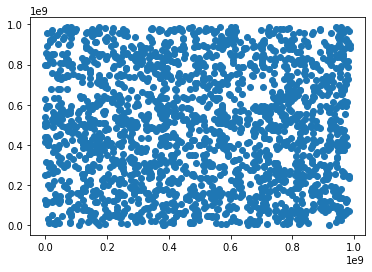

In [ ]:
# Checking pseudo-random numbers - looks better
import matplotlib.pyplot as plt

N = 1000
a = 1234567
c = 123456789
m = 987654321
x = 1
y = 0
xvalues = []
yvalues = []

for i in range(N):
  y = (a*x+c)%m
  xvalues.append(x)
  yvalues.append(y)
  x = (a*y+c)%m
  xvalues.append(x)
  yvalues.append(y)

plt.scatter(xvalues,yvalues)
plt.show()

Animation size has reached 20974164 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


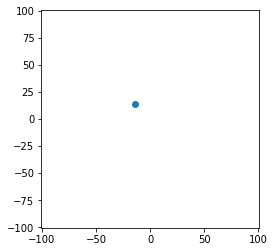

In [ ]:
#Brownian motion!

from math import log
from random import randrange
import matplotlib.pyplot as plt
from matplotlib import animation, rc
import numpy as np
from IPython.display import HTML

L = 201
N = 10000
####N = 1000000
framerate = 1

x = y = 0

def animate(i):
  global x,y
  # Main loop
  ###print(pos[i,0],pos[i,1])
  # Main loop
  direction = randrange(4)
  if (direction == 0):
    if x < L/2: x += 1
  elif (direction == 1):
    if x > -L/2: x -= 1
  elif (direction == 2):
    if y < L/2: y += 1
  else:
    if y > -L/2: y -= 1
  point.set_data(x,y)
  return point,

fig = plt.figure()
ax = plt.axes(xlim=(-L/2, L/2), ylim=(-L/2,L/2))
ax.set_aspect("equal")
# create a point in the axes
point, = ax.plot(x,y, marker="o")


ani = animation.FuncAnimation(fig, animate, interval=framerate, frames = N, blit=True)
###plt.show()
#ani.save('brownian_motion_2d.mp4', fps=60, extra_args=['-vcodec', 'libx264'])
rc('animation', html='jshtml')
ani


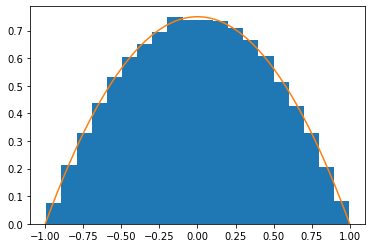

In [ ]:
import matplotlib.pyplot as plt

# Implementation of accept/reject sampling for a continuous variable.
# Pass the Python function, the range of potential x values as a tuple (xmin, xmax), and the maximum value for f(x) to assume
def accept_reject(func, rng, maxval):
    from random import uniform
    while True:
        xtest = uniform(*rng)
        y = func(xtest)/maxval
        if y > 1:
            print(f"Problem: function ({y*maxval}) has exceeded maxval {maxval} for x {xtest}")
        ytest = uniform(0,1)
        if ytest < y:
            return xtest


# example. some arbitrary PDF:
def quadratic(x):
    return 0.75*(1.-x*x) if -1 < x < 1 else 0

# some points:
points = []
N = 50000
for x in range(N):
  points.append(accept_reject(quadratic, (-1,1), 1))

# compare histogram of generated points to PDF
plt.hist(points, bins=20, density=True)
plt.plot(numpy.linspace(-1,1,1000), numpy.frompyfunc(quadratic, 1, 1)(numpy.linspace(-1,1,1000)))
plt.show()


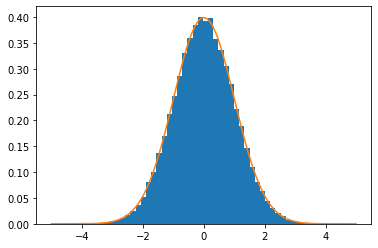

In [ ]:
import matplotlib.pyplot as plt
from numpy import exp,power,frompyfunc,linspace,sqrt,pi

# Implementation of accept/reject sampling for a continuous variable.
# Pass the Python function, the range of potential x values as a tuple (xmin, xmax), and the maximum value for f(x) to assume
def accept_reject(func, rng, maxval):
    from random import uniform
    while True:
        xtest = uniform(*rng)
        y = func(xtest)/maxval
        if y > 1:
            print(f"Problem: function ({y*maxval}) has exceeded maxval {maxval} for x {xtest}")
        ytest = uniform(0,1)
        if ytest < y:
            return xtest


xmax=5

# truncated Gaussian, width 1, mean 0
def trunc_gaus(x):
  return 1./(sqrt(2*pi))*exp(-0.5*power(x,2)) if abs(x) < xmax else 0

# some points:
points = []
N = 50000
for x in range(N):
  points.append(accept_reject(trunc_gaus, (-xmax,xmax), 0.5))

# compare histogram of generated points to PDF
plt.hist(points, bins=50,density=True)
plt.plot(linspace(-xmax,xmax,1000), frompyfunc(trunc_gaus, 1, 1)(linspace(-xmax,xmax,1000)))
plt.show()


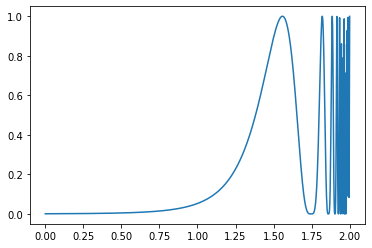

In [ ]:
# Ugly function that we want to integrate
from math import sin
from random import random
from matplotlib import pyplot as plot
import numpy as np

def f(x):
  return (sin(x/(x*(2-x)*(3-x))))**4

epsilon = 1e-8 ### so we don't divide by zero
xmin=0+epsilon
xmax=2-epsilon
N=1000
xlist = np.linspace(xmin, xmax, N)
ylist=[]
for x in xlist:
  ylist.append(f(x))

plot.plot(xlist,ylist)
plot.show()

In [ ]:
# Example MC integration
from math import sin
from random import random
from matplotlib import pyplot as plot
import numpy as np

def f(x):
  return (sin(x/(x*(2-x)*(3-x))))**4

epsilon = 1e-8 ### so we don't divide by zero
xmin=0+epsilon
xmax=2-epsilon
N=100000
xlist = np.linspace(xmin, xmax, N)
ylist=[]
count = 0
for i in range(N):
  randx = 2*random()
  randy = random()
  if (randy < f(randx)):
    count = count + 1

print(2*count/N)

0.41076


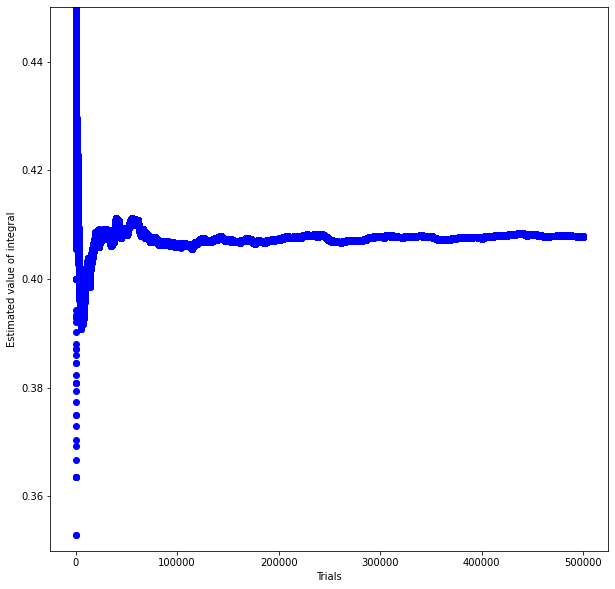

In [ ]:
#Checking convergence of MC Integration
from math import sin
from random import random
from matplotlib import pyplot as plot
import numpy as np

def f(x):
  return (sin(x/(x*(2-x)*(3-x))))**4

epsilon = 1e-8 ### so we don't divide by zero
xmin=0+epsilon
xmax=2-epsilon
N=500000
xlist = []
ylist=[]
count = 0
for i in range(N):
  randx = 2*random()
  randy = random()
  if (randy < f(randx)):
    count = count + 1
  ylist.append(2*count/(i+1))
  xlist.append(i+1)

plot.figure(figsize=(10,10))
plot.ylim(0.35,0.45)
plot.scatter(xlist,ylist,color='b')
plot.ylabel("Estimated value of integral")
plot.xlabel("Trials")
plot.show()

In [ ]:
1./(500000**0.5)

0.001414213562373095

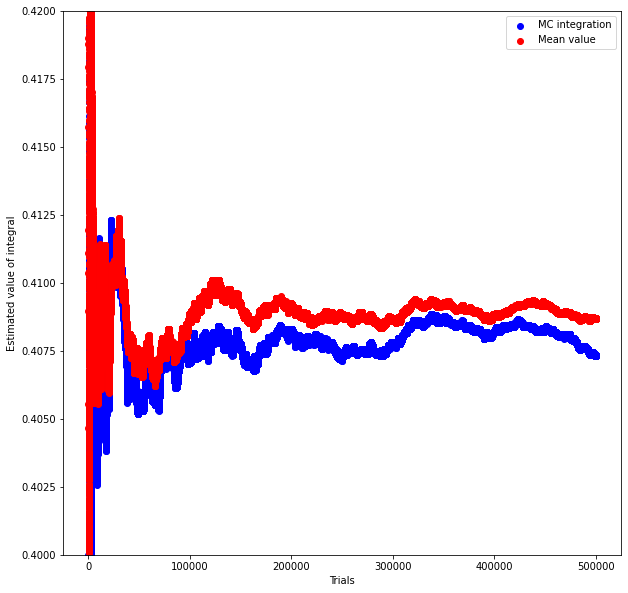

In [ ]:
# Mean Value vs MC Integration
from math import sin
from random import random
from matplotlib import pyplot as plot
import numpy as np

def f(x):
  return (sin(x/(x*(2-x)*(3-x))))**4

epsilon = 1e-8 ### so we don't divide by zero
xmin=0+epsilon
xmax=2-epsilon
N=500000
xlist = []
ylist =[]
ylist_mvm=[]
count = 0
sum = 0
for i in range(N):
  randx = 2*random()
  randy = random()
  val = f(randx)
  sum = sum + val
  if (randy < val):
    count = count + 1
  ylist.append(2*count/(i+1))
  xlist.append(i+1)
  ylist_mvm.append(2*sum/(i+1))


ax = plot.figure(figsize=(10,10))
plot.ylim(0.4,0.42)
plot.scatter(xlist,ylist,color='b',label='MC integration')
plot.scatter(xlist,ylist_mvm,color='r',label='Mean value')
plot.legend(loc='upper right')
plot.ylabel("Estimated value of integral")
plot.xlabel("Trials")
plot.show()

In [ ]:
# The "slow" way, maybe easier at first, and still faster than much of the above
import numpy

N = 500000
x_values = numpy.random.uniform(0, 1, N)
results = numpy.zeros(N)

print("done generating random numbers")

for attempt in range(N):
    results[attempt] = math.sqrt(1-x_values[attempt]**2)
    
# our estimate of the integral (=pi/4) is the total value of results, times the range we're choosing random numbers over
# (1), divided by the number of attempts (= the mean result * 1)
print(f"Our estimate of pi: {results.mean()*4}")

done generating random numbers
Our estimate of pi: 3.1401902617790585


In [ ]:
# the "fast" way, using numpy tricks
import numpy
N = 500000
x_values = numpy.random.uniform(0, 1, N)
results = numpy.sqrt(1-x_values**2) # evaluate all together
print(f"Our estimate of pi: {results.mean()*4}")

Our estimate of pi: 3.137673840785929


In [ ]:
# Cartestian Product check
from itertools import product 

die = [1,2,3,4,5,6]
Ndice = 2

comb = product(die,repeat=Ndice)
for i in list(comb):
  print(i)

(1, 1)
(1, 2)
(1, 3)
(1, 4)
(1, 5)
(1, 6)
(2, 1)
(2, 2)
(2, 3)
(2, 4)
(2, 5)
(2, 6)
(3, 1)
(3, 2)
(3, 3)
(3, 4)
(3, 5)
(3, 6)
(4, 1)
(4, 2)
(4, 3)
(4, 4)
(4, 5)
(4, 6)
(5, 1)
(5, 2)
(5, 3)
(5, 4)
(5, 5)
(5, 6)
(6, 1)
(6, 2)
(6, 3)
(6, 4)
(6, 5)
(6, 6)


In [ ]:
# Combinatorics problem
from itertools import product 
from math import pow
die = [1,2,3,4,5,6]
Ndice = 10
Ncomb = pow(len(die),Ndice)
toget = 32
nmatch = 0
for i in product(die,repeat=Ndice):
  if (sum(i) == toget): nmatch = nmatch + 1
print("We found ",nmatch," out of ", Ncomb, "for a probability of ",float(nmatch)/Ncomb)

We found  3801535  out of  60466176.0 for a probability of  0.06287043850763772


In [ ]:
# Combinatorics problem
# MC method
import random
Ndice = 10
toget = 32
nmatch = 0
Ntrial = 5000000
for trial in range(Ntrial):
  sum = 0
  for die in range(Ndice):
    roll = random.randint(1,6) ### a single die
    sum = sum+roll
  if (sum == toget): nmatch = nmatch + 1
print("We found ",nmatch," out of ", Ntrial, "for a probability of ",float(nmatch)/Ntrial)

We found  315030  out of  5000000 for a probability of  0.063006


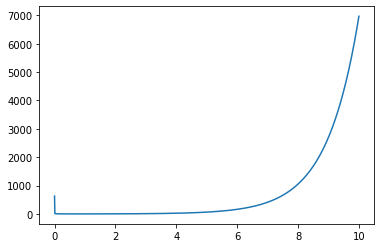

In [ ]:
# function to integrate
import matplotlib.pyplot as plt
from numpy import exp,power,frompyfunc,linspace,sqrt,pi

def func(x):
  return (1./sqrt(x))*(1+exp(x))

xmin=1e-5 ##don't start at 0 where function diverges!
xmax=10
N=1000

plt.plot(linspace(xmin,xmax,N), frompyfunc(func, 1, 1)(linspace(xmin,xmax,N)))
plt.show()

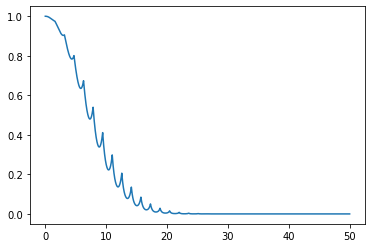

In [ ]:
# Another function for importance sampling
import matplotlib.pyplot as plt
from numpy import exp,power,frompyfunc,linspace,sqrt,pi,random,sin,abs,cos

alpha = 0.01
N=100000
# random integral
def func(x):
  return exp(-x*x*alpha*(abs(sin(x))+abs(cos(x))))

xmin=0
xmax=50
plt.plot(linspace(xmin,xmax,N), frompyfunc(func, 1, 1)(linspace(xmin,xmax,N)))
plt.show()

In [ ]:
# Integral without importance sampling
import matplotlib.pyplot as plt
from numpy import exp,power,frompyfunc,linspace,sqrt,pi,random,sin,abs,cos,array,sum,array

### redo using flat sampling from 0 to 200 (integral rapidly goes to zero)
alpha = 0.01
N=10000000
alpha_inv = 1./alpha

# random integral
def func(x):
  return exp(-x*x*alpha*(abs(sin(x))+abs(cos(x))))

xmin=0
xmax=200
## choose sample alpha as above, but it doesn't have to be!
x_values = random.uniform(0,50,N)
vals = array([func(xi) for xi in x_values])
### now need to multiply by (b-a)
integral = (xmax - xmin)*sum(vals)/N
print("Integral using N = ",N,"points is ",integral)

Integral using N =  10000000 points is  31.529579494241684


In [ ]:
# Integrate with importance sampling
import matplotlib.pyplot as plt
from numpy import exp,power,frompyfunc,linspace,sqrt,pi,random,sin,abs,cos,array,sum,array

alpha = 0.01
N=1000000

# random integral
def func(x):
  return exp(-x*x*alpha*(abs(sin(x))+abs(cos(x))))

## Choose a width of 10 based on above graph, doesn't have to be, of course. We use absolute value since we only care about x>0!
sigma=10
x_values = abs(random.normal(0,sigma,N))

def gauss_func(x):
  return 1./(sqrt(2*pi)*sigma)*exp((-0.5*x*x)/(2*sigma*sigma))


vals = array([func(xi)/gauss_func(xi) for xi in x_values])
## integral was defined conveniently to have unit normalization from 0 to infinity, we used only half but we doubled with absolute value
integral = sum(vals)/N
print("Integral using N = ",N,"points is ",integral)

Integral using N =  1000000 points is  14.402286823430092


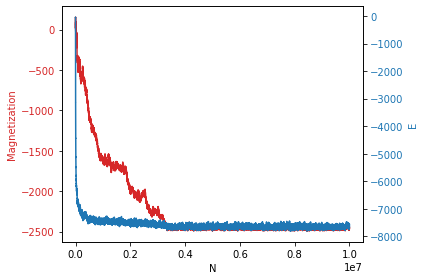

In [ ]:
# Ising model 10.9
# using numpy array manipulation. Note that we calculate the energy sum over and over, 
# so even though numpy is efficient, the overall calculation is not
from math import exp
from numpy import empty,sum,arange
from random import random, randrange
from pylab import plot,show,xlabel,ylabel,subplots

L = 50
N = 10000000
J = 1.6
T = 2.3

# Function to calculate the energy
def energy(s):
  return -J*(sum(s[0:L-1,:]*s[1:L,:]) + sum(s[:,0:L-1]*s[:,1:L]))

# Initial state
s = empty([L,L],int)
for i in range(L):
  for j in range(L):
    if random() < 0.5:
      s[i,j] = +1
    else:
      s[i,j] = -1
E = energy(s)
M = sum(s)

# Main loop
mpoints = []
epoints = []
xpoints = arange(N)
for k in range(N):
  mpoints.append(M)
  epoints.append(E)

  # Save current energy
  oldE = E

  # Choose a random spin, flip it, and calculate dE.
  i = randrange(L)
  j = randrange(L)
  s[i,j] = -s[i,j]
  # We could probably be move clever since "most" of the calculation doesn't change, only nearest neighbors
  E = energy(s)
  deltaE = E - oldE

  # Decide whether to accept the move or not
  if deltaE > 0.0: ### If dE < 0 we always keep things
    if random() > exp(-deltaE/T): 
      # Move rejected, revert to old state, don't need to recalculate M, we haven't changed it
      s[i,j] = -s[i,j]
      E = oldE
      continue
  # Accepted! Calculate new values
  M = sum(s)

# Make the plots


fig, ax1 = subplots()
color = 'tab:red'
ax1.set_xlabel('N')
ax1.set_ylabel('Magnetization', color=color)
ax1.plot(xpoints, mpoints, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('E', color=color)  # we already handled the x-label with ax1
ax2.plot(xpoints, epoints, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped

Can see the magnetization quickly approaching the maximum value it can have (in absolute value). In another iteration that could be positive, not negative. But now let's try and be smarter about how we calculate things (also being more careful about edge effects), though we still use numpy initially and also to calculate the magnetization

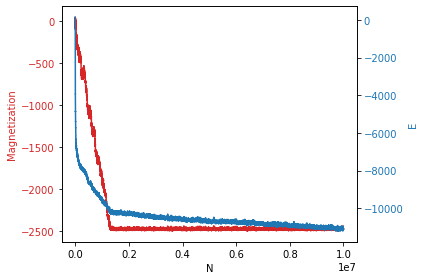

In [ ]:
from math import exp
from numpy import empty,sum,arange
from random import random, randrange
from pylab import plot,show,xlabel,ylabel,subplots

L = 50
N = 10000000
J = 1.6
T = 2.3

# Function to calculate the energy
def energy(s):
  return -J*(sum(s[0:L-1,:]*s[1:L,:]) + sum(s[:,0:L-1]*s[:,1:L]))

# Initial state
s = empty([L,L],int)
for i in range(L):
  for j in range(L):
    if random() < 0.5:
      s[i,j] = +1
    else:
      s[i,j] = -1
E = energy(s)
M = sum(s)

# Main loop
mpoints = []
epoints = []
xpoints = arange(N)
for k in range(N):
  mpoints.append(M)
  epoints.append(E)

  # Save current energy
  oldE = E

  # Choose a random spin, flip it, and calculate dE
  i = randrange(L)
  j = randrange(L)
  # We could probably be move clever since "most" of the calculation doesn't change, only nearest neighbors
  # So let's try that here. We will flip the spin AFTER after calculating dE, too
  #E = energy(s)
  #deltaE = E - oldE
  iup = i+1
  idown = i-1
  jup = j+1
  jdown = j-1
  if (iup == L): iup = 0
  if (idown == 0): idown = L-1
  if (jup == L): jup = 0
  if (jdown == 0): jdown = L-1
  ### Factor of two comes from (1 - (-1) = 2)
  deltaE = 2*J*s[i,j]*(s[iup,j]+s[idown,j]+s[i,jup]+s[i,jdown])
  E = deltaE + oldE
  ### Flip!
  s[i,j] = -s[i,j]
  # Decide whether to accept the move or not
  if deltaE > 0.0: ### If dE < 0 we always keep things
    if random() > exp(-deltaE/T): 
      # Move rejected, revert to old state, don't need to recalculate M, we haven't changed it
      s[i,j] = -s[i,j]
      E = oldE
      continue
  # Accepted! Calculate new values
  M = sum(s)

# Make the plots


fig, ax1 = subplots()
color = 'tab:red'
ax1.set_xlabel('N')
ax1.set_ylabel('Magnetization', color=color)
ax1.plot(xpoints, mpoints, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('E', color=color)  # we already handled the x-label with ax1
ax2.plot(xpoints, epoints, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped

That was faster! Let's try something bigger, so we use more N, too


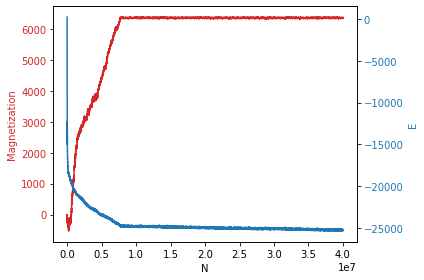

In [ ]:
from math import exp
from numpy import empty,sum,arange
from random import random, randrange
from pylab import plot,show,xlabel,ylabel,subplots

L = 80
N = 40000000
J = 1.6
T = 2.0

# Function to calculate the energy
def energy(s):
  return -J*(sum(s[0:L-1,:]*s[1:L,:]) + sum(s[:,0:L-1]*s[:,1:L]))

# Initial state
s = empty([L,L],int)
for i in range(L):
  for j in range(L):
    if random() < 0.5:
      s[i,j] = +1
    else:
      s[i,j] = -1
E = energy(s)
M = sum(s)
# Main loop
mpoints = []
epoints = []
xpoints = arange(N)
for k in range(N):
  mpoints.append(M)
  epoints.append(E)

  # Save current energy
  oldE = E

  # Choose a random spin, flip it, and calculate dE
  i = randrange(L)
  j = randrange(L)
  # We could probably be move clever since "most" of the calculation doesn't change, only nearest neighbors
  # So let's try that here. We will flip the spin AFTER after calculating dE, too
  #E = energy(s)
  #deltaE = E - oldE
  #be more careful now about the boundary conditions, too
  iup = i+1
  idown = i-1
  jup = j+1
  jdown = j-1
  if (iup == L): iup = 0
  if (idown == 0): idown = L-1
  if (jup == L): jup = 0
  if (jdown == 0): jdown = L-1
  ### Factor of two comes from (1 - (-1) = 2)
  deltaE = 2*J*s[i,j]*(s[iup,j]+s[idown,j]+s[i,jup]+s[i,jdown])
  E = deltaE + oldE
  ### Flip!
  s[i,j] = -s[i,j]
  # Decide whether to accept the move or not
  if deltaE > 0.0: ### If dE < 0 we always keep things
    if random() > exp(-deltaE/T): 
      # Move rejected, revert to old state, don't need to recalculate M, we haven't changed it
      s[i,j] = -s[i,j]
      E = oldE
      continue
  # Accepted! Calculate new values
  M = sum(s)

# Make the plots


fig, ax1 = subplots()
color = 'tab:red'
ax1.set_xlabel('N')
ax1.set_ylabel('Magnetization', color=color)
ax1.plot(xpoints, mpoints, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
ax2.set_ylabel('E', color=color)  # we already handled the x-label with ax1
ax2.plot(xpoints, epoints, color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()  # otherwise the right y-label is slightly clipped